In [1]:
!sudo apt-get install tesseract-ocr
!sudo apt-get install tesseract-ocr-rus
!wget https://github.com/tesseract-ocr/tessdata/raw/master/eng.traineddata

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  tesseract-ocr-eng tesseract-ocr-osd
The following NEW packages will be installed:
  tesseract-ocr tesseract-ocr-eng tesseract-ocr-osd
0 upgraded, 3 newly installed, 0 to remove and 37 not upgraded.
Need to get 4,795 kB of archives.
After this operation, 15.8 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 tesseract-ocr-eng all 4.00~git24-0e00fe6-1.2 [1,588 kB]
Get:2 http://archive.ubuntu.com/ubuntu bionic/universe amd64 tesseract-ocr-osd all 4.00~git24-0e00fe6-1.2 [2,989 kB]
Get:3 http://archive.ubuntu.com/ubuntu bionic/universe amd64 tesseract-ocr amd64 4.00~git2288-10f4998a-2 [218 kB]
Fetched 4,795 kB in 3s (1,637 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl

In [2]:
pip install pytesseract

  Created wheel for pytesseract: filename=pytesseract-0.3.8-py2.py3-none-any.whl size=14072 sha256=d9e209ba1d6ff343fa3cdfb579a5d49966a6864a876afdeaef8d5ede18e81bac
  Stored in directory: /root/.cache/pip/wheels/a4/89/b9/3f11250225d0f90e5454fcc30fd1b7208db226850715aa9ace
Successfully built pytesseract


In [3]:
import numpy as np
import matplotlib.pylab as plt
import skimage 
import cv2 
import skimage.color
from skimage.filters import (threshold_otsu, threshold_niblack,
                             threshold_sauvola)
import skimage.feature
from scipy.signal import find_peaks
import pytesseract
from PIL import Image
import skimage.exposure
from skimage.transform import hough_line, hough_line_peaks
from glob import glob
import os

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


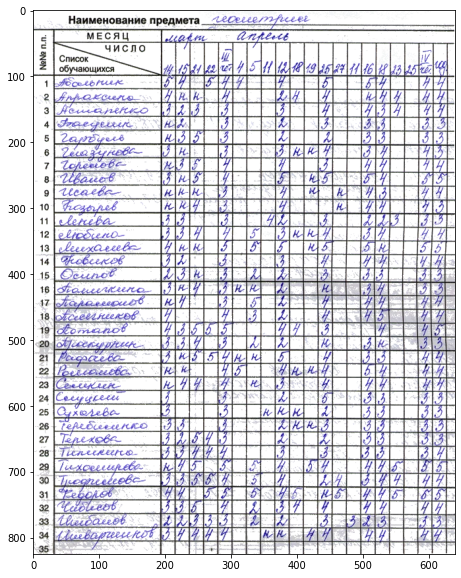

In [5]:
test_image = plt.imread("/content/drive/MyDrive/journal_data/test4.png")
plt.figure(figsize=(10, 10))
plt.imshow(test_image)
plt.show()

In [6]:
print(test_image.shape)
print(test_image.min(), test_image.max(), test_image.dtype)

(825, 640, 3)
0.0 1.0 float32


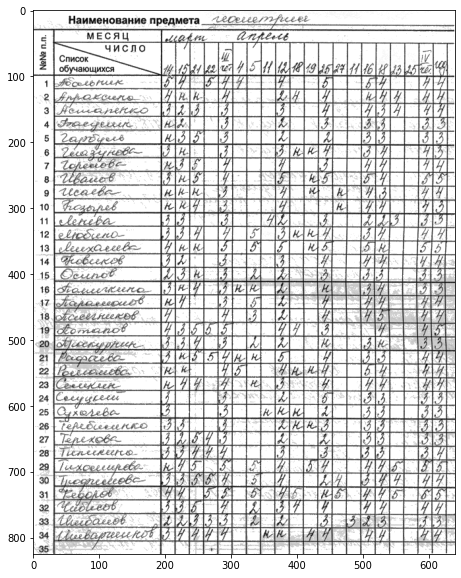

In [7]:
image_gray = skimage.color.rgb2gray(test_image)
plt.figure(figsize=(10, 10))
plt.imshow(image_gray, cmap='gray')
plt.show()

## Histogram


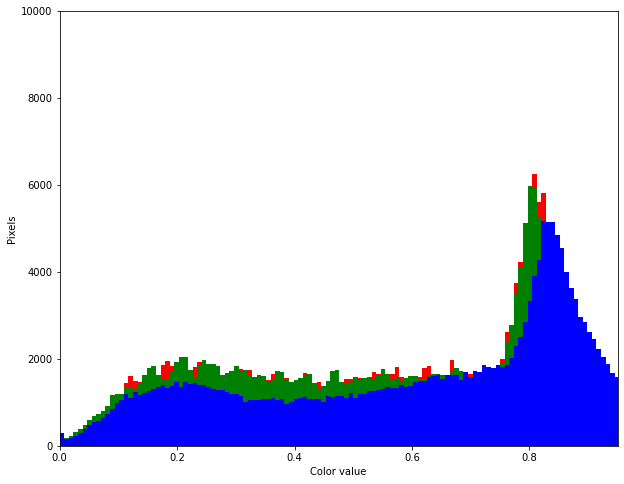

In [8]:
colors = ("r", "g", "b")
channel_ids = (0, 1, 2)

# create the histogram plot, with three lines, one for
# each color
plt.figure(figsize=(10, 8))
plt.xlim([0, 0.95])
plt.ylim([0, 10000])
for channel_id, c in zip(channel_ids, colors):
    plt.hist(test_image[:, :, channel_id].flatten(), bins=128, color = c)

plt.xlabel("Color value")
plt.ylabel("Pixels")

plt.show()

In [9]:
def print_hist(orig_img, process_img):  
  colors = ("r", "g", "b")
  channel_ids = (0, 1, 2)

  fig, axs = plt.subplots(1, 2, figsize = (18, 10))
  
  for channel_id, c in zip(channel_ids, colors):
      axs[0].hist(orig_img[:, :, channel_id].flatten(), bins=128, color=c)

  for channel_id, c in zip(channel_ids, colors):
      axs[1].hist(process_img[:, :, channel_id].flatten(), bins=128, color=c)

  for ax in axs.flat:
    ax.set(xlabel="Color value", ylabel="Pixels")
  axs.flat[0].set(xlim = [0, 0.95], ylim = [0, 10000])

  plt.show()

In [10]:
def equalize_image(img, kernel_size_ratio = 3, clip_lim = 0.1):
  hsv_img = skimage.color.rgb2hsv(img)
  hsv_img[...,2] = skimage.exposure.equalize_adapthist(hsv_img[...,2], 
                                                       kernel_size = (img.shape[0]//kernel_size_ratio, img.shape[1]//kernel_size_ratio), 
                                                       clip_limit=clip_lim)
  test_image_adapt = skimage.color.hsv2rgb(hsv_img)

  return test_image_adapt

In [ ]:
for f_name in os.listdir("/content/drive/MyDrive/journal_data/"):
  img = plt.imread(os.path.join("/content/drive/MyDrive/journal_data/", f_name))
  test_image_adapt = equalize_image(img, kernel_size_ratio = 3)

  fig, ax = plt.subplots(1, 2, figsize=(18, 18))
  ax[0].imshow(img)
  ax[1].imshow(test_image_adapt)
  print(f_name)
  plt.show()
  print_hist(img, test_image_adapt)

## Thresholding



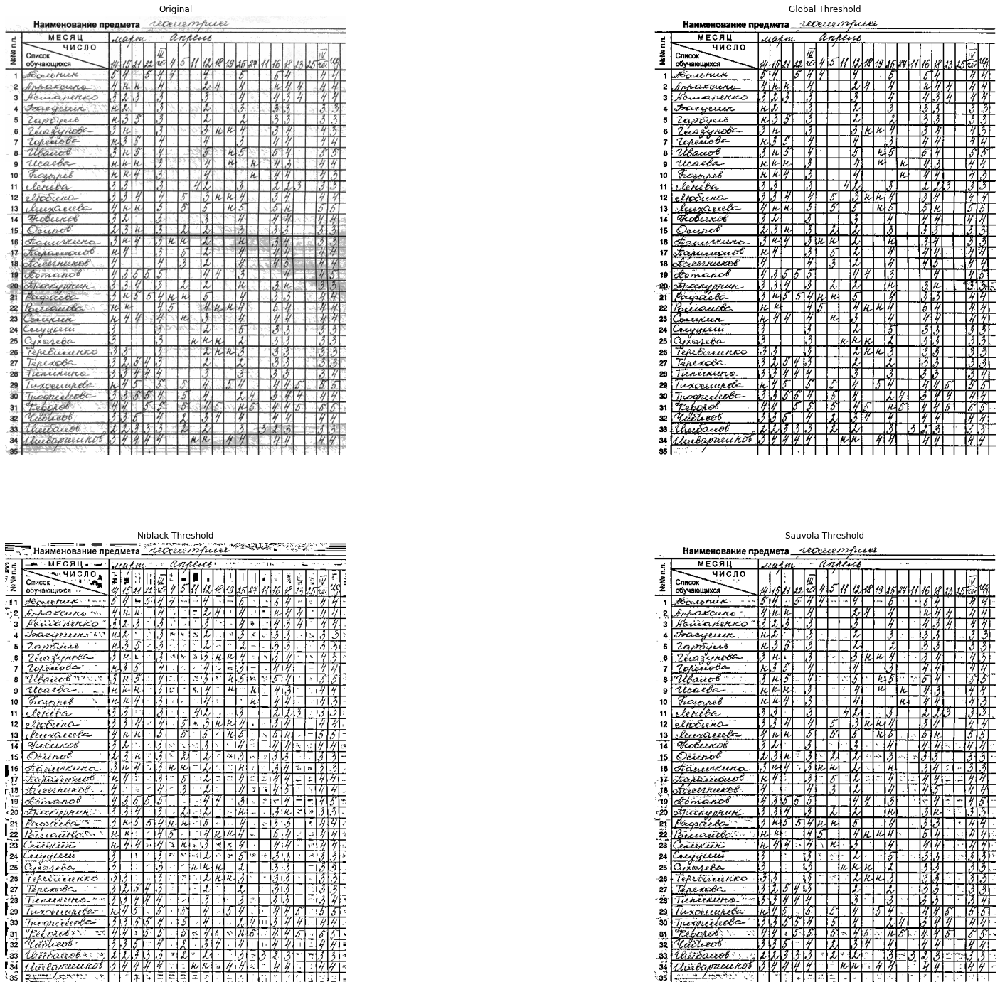

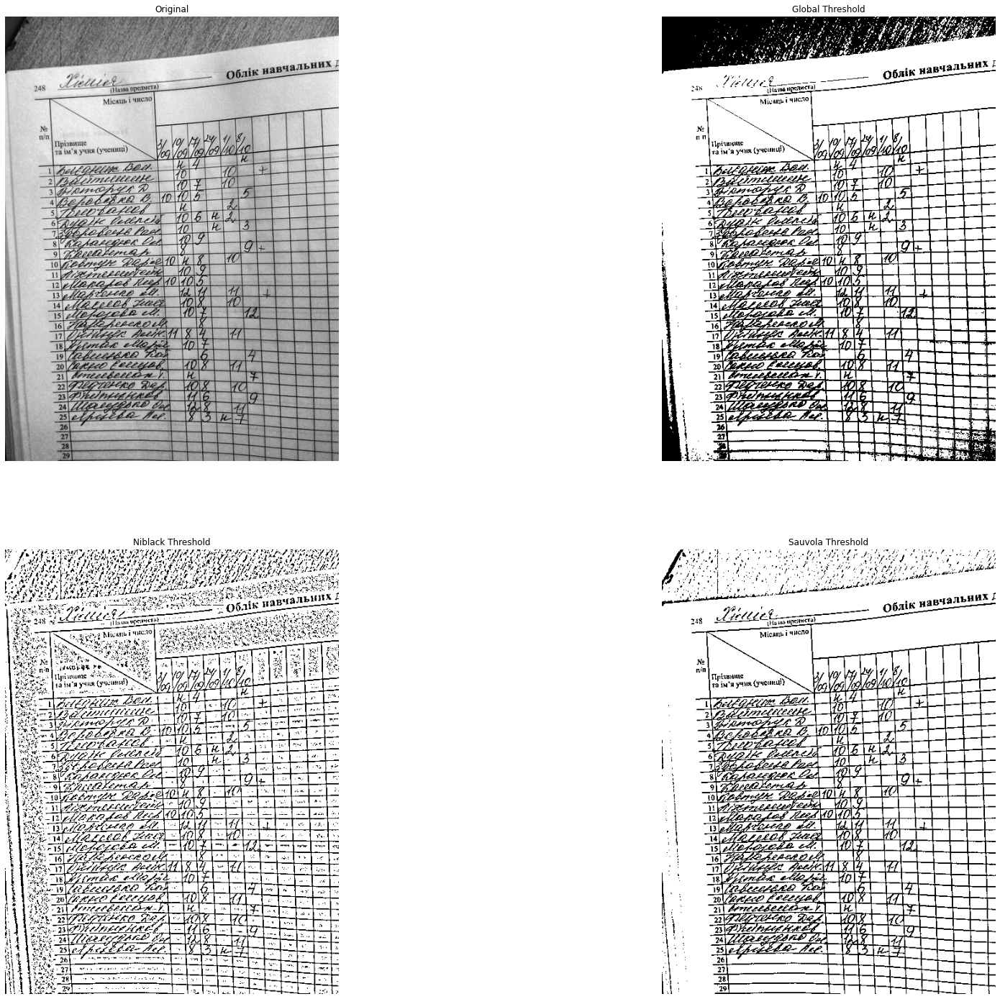

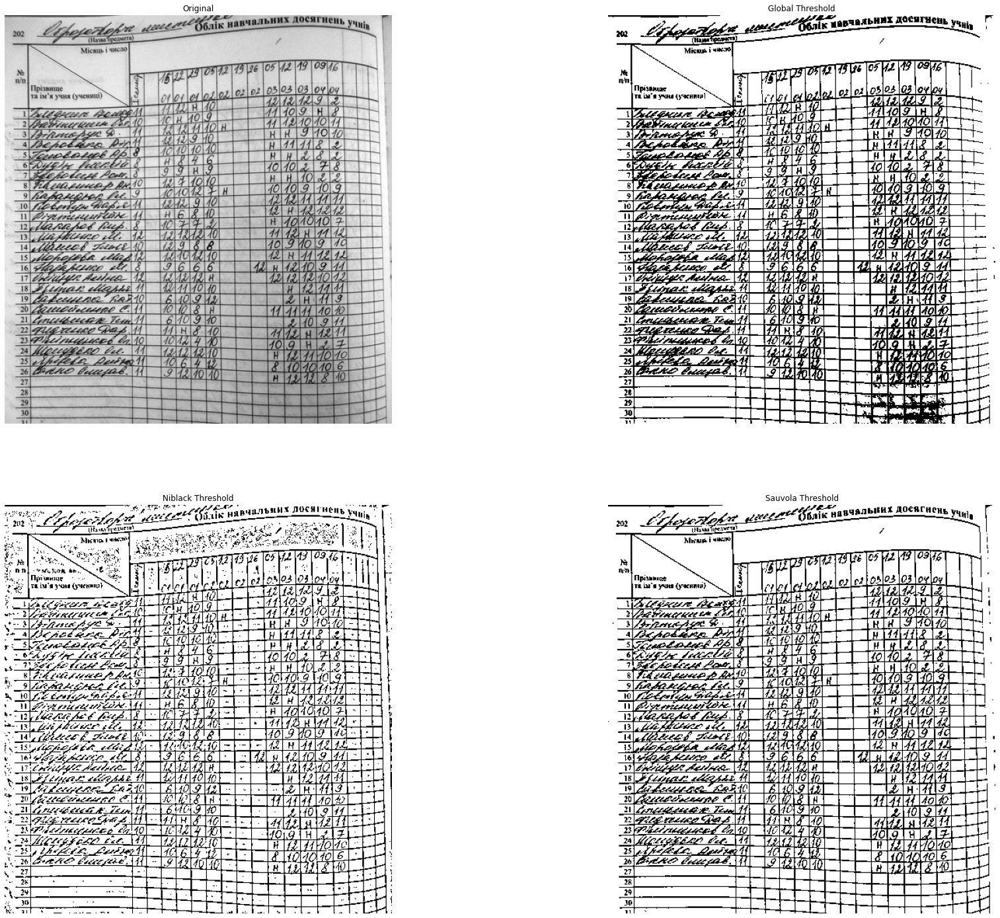

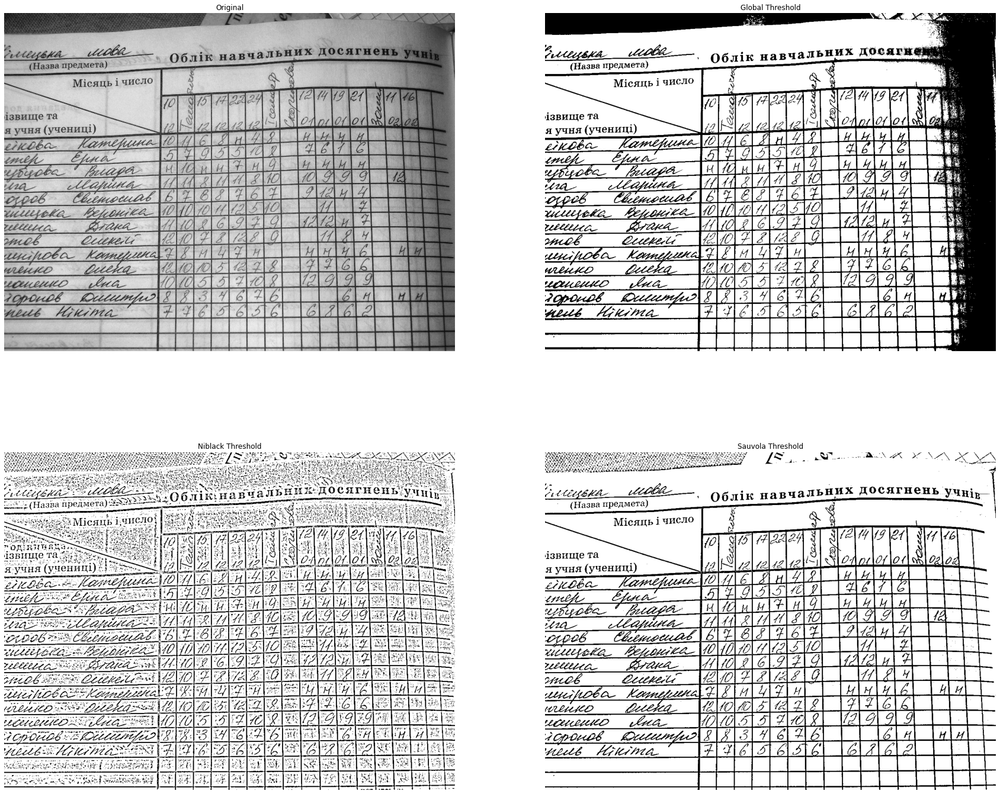

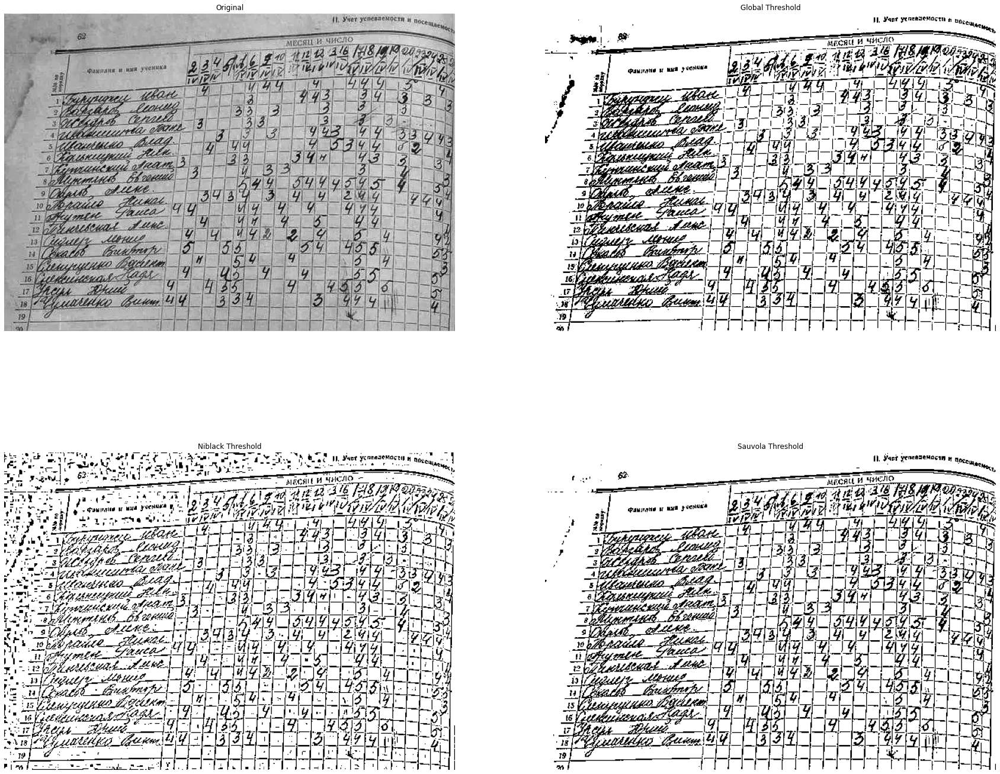

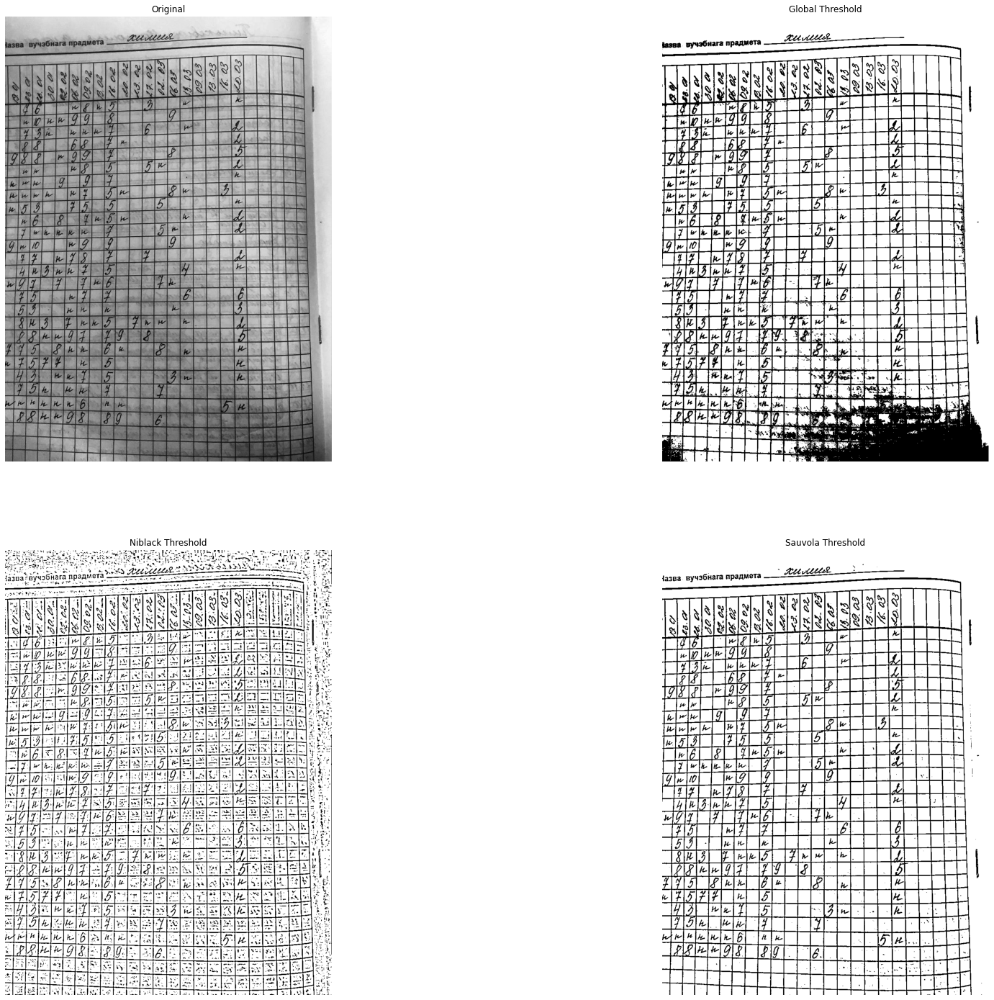

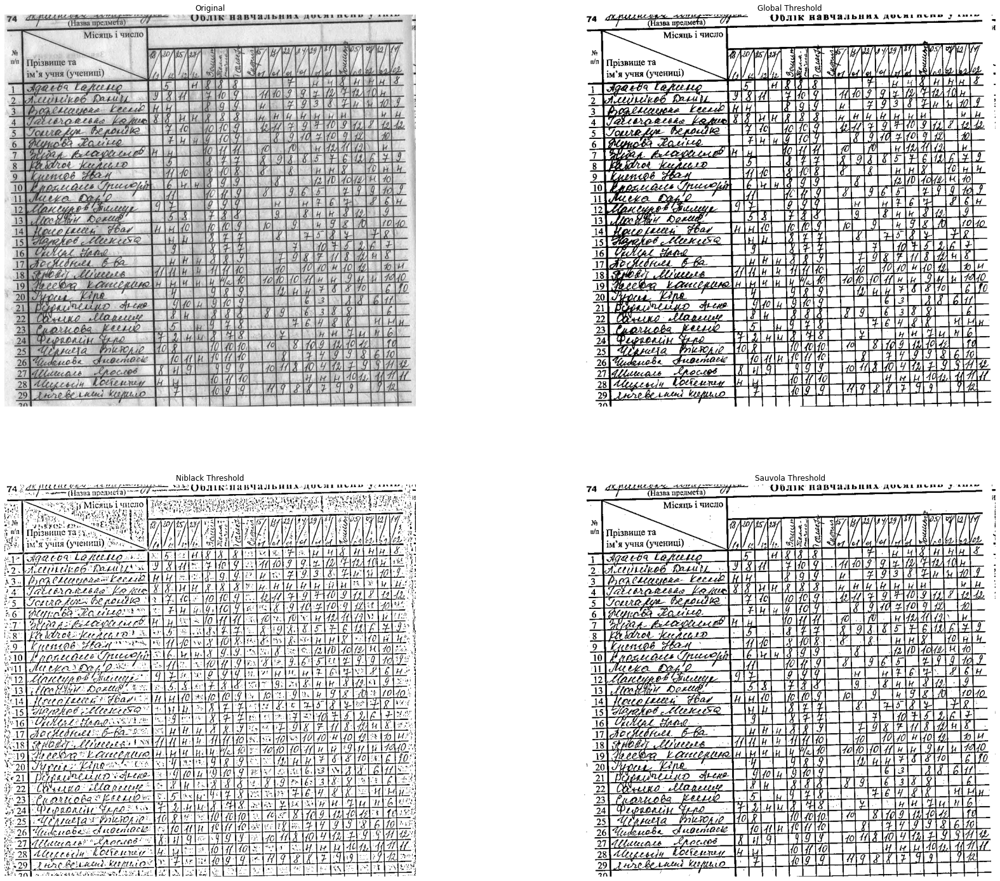

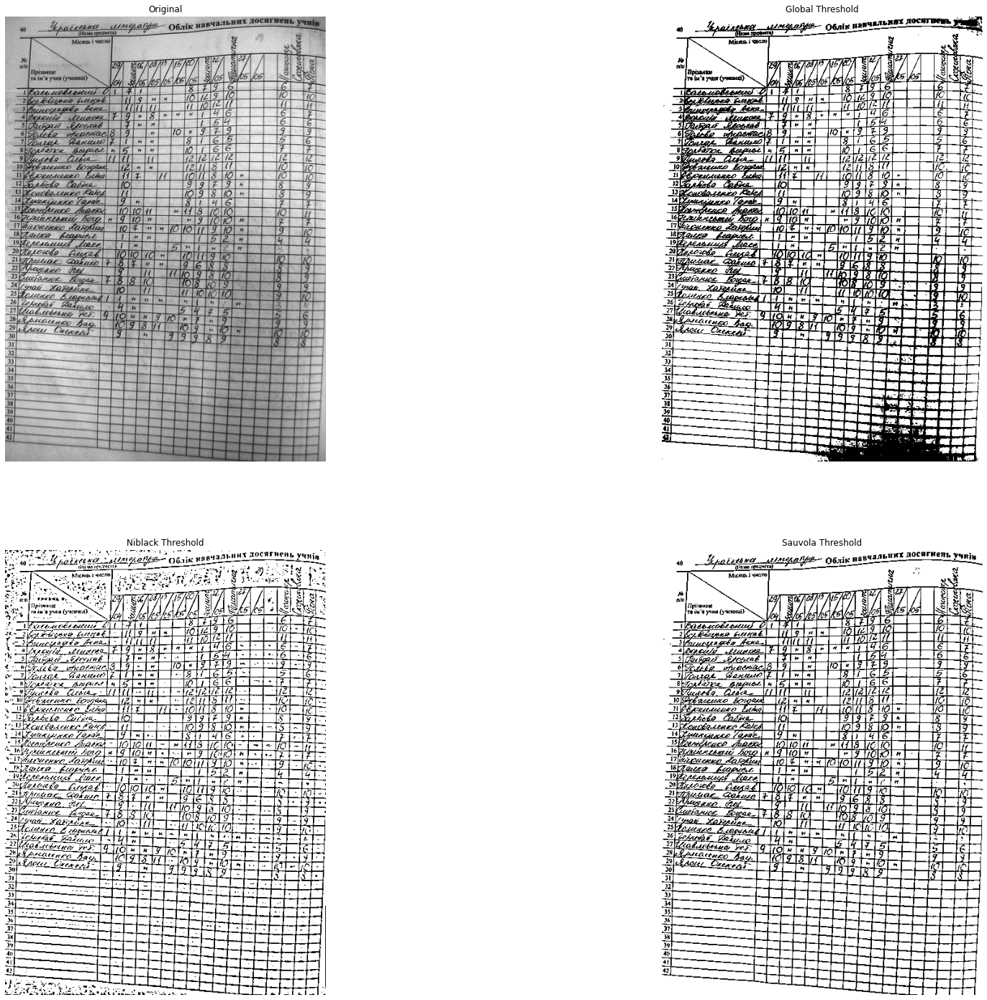

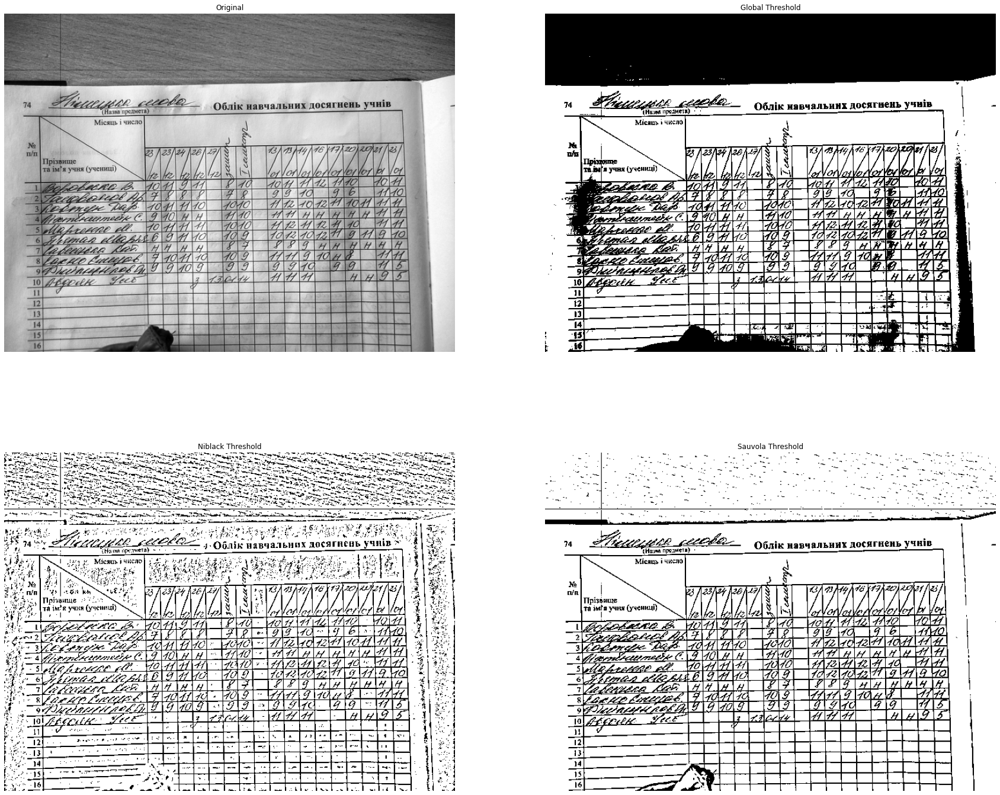

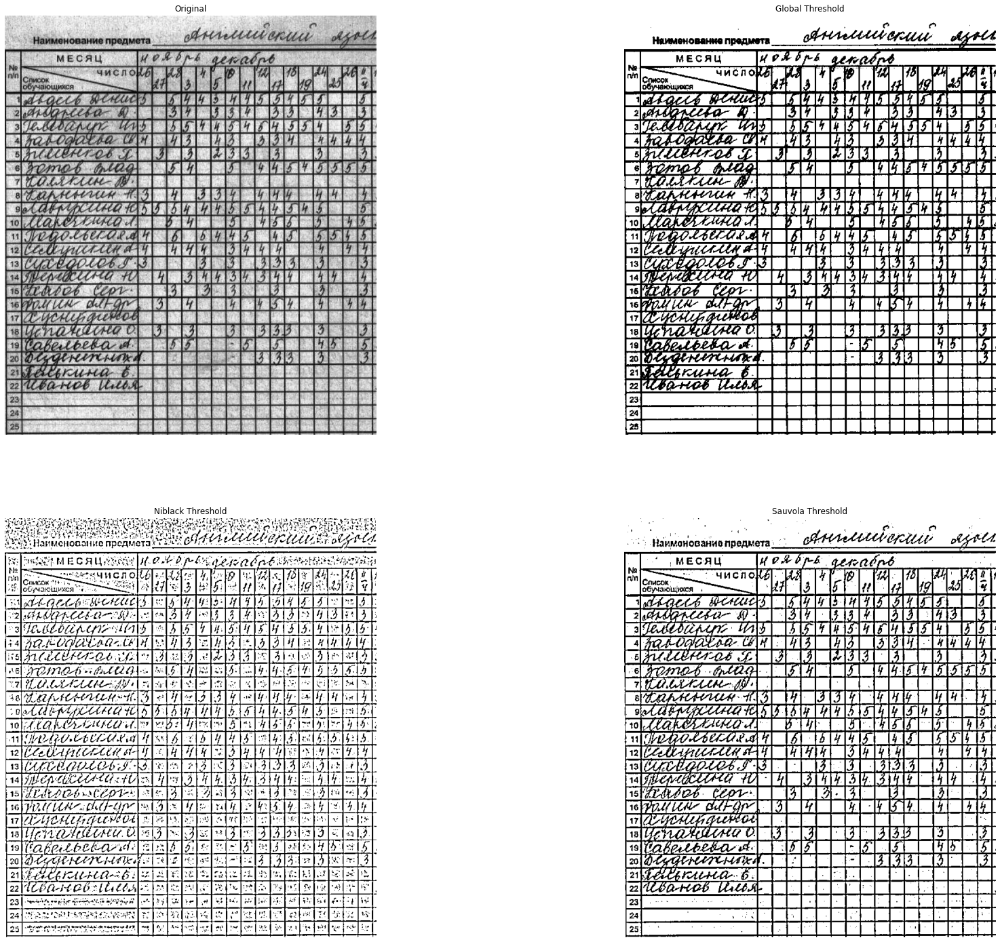

In [ ]:
for f_name in os.listdir("/content/drive/MyDrive/journal_data/"):
  img = plt.imread(os.path.join("/content/drive/MyDrive/journal_data/", f_name))
  img = equalize_image(img, kernel_size_ratio = 3, clip_lim=0.01)
  img_gray = skimage.color.rgb2gray(img)

  binary_global = img_gray > threshold_otsu(img_gray)

  window_size = 11
  thresh_niblack = threshold_niblack(img_gray, window_size=window_size, k=0.8)
  thresh_sauvola = threshold_sauvola(img_gray, window_size=window_size)

  binary_niblack = img_gray > thresh_niblack
  binary_sauvola = img_gray > thresh_sauvola

  plt.figure(figsize=(30, 25))
  plt.subplot(2, 2, 1)
  plt.imshow(img_gray, cmap=plt.cm.gray)
  plt.title('Original')
  plt.axis('off')

  plt.subplot(2, 2, 2)
  plt.title('Global Threshold')
  plt.imshow(binary_global, cmap=plt.cm.gray)
  plt.axis('off')

  plt.subplot(2, 2, 3)
  plt.imshow(binary_niblack, cmap=plt.cm.gray)
  plt.title('Niblack Threshold')
  plt.axis('off')

  plt.subplot(2, 2, 4)
  plt.imshow(binary_sauvola, cmap=plt.cm.gray)
  plt.title('Sauvola Threshold')
  plt.axis('off')

  plt.show()

## Filtering


In [ ]:
edges1 = skimage.feature.canny(image_gray, sigma=1)

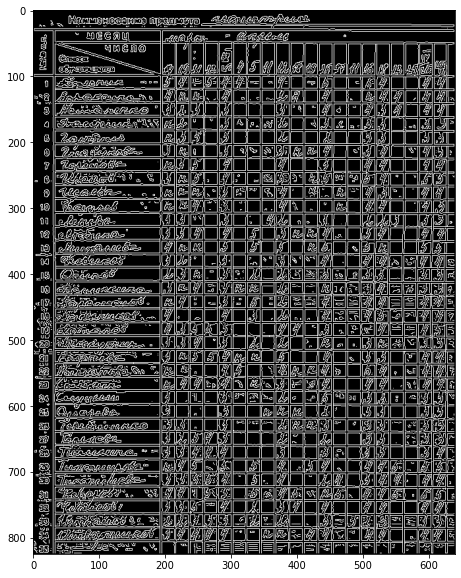

In [ ]:
plt.figure(figsize=(10, 10))
plt.imshow(edges1, cmap='gray')
plt.show()

In [ ]:
edges2 = skimage.filters.sobel_v(image_gray)

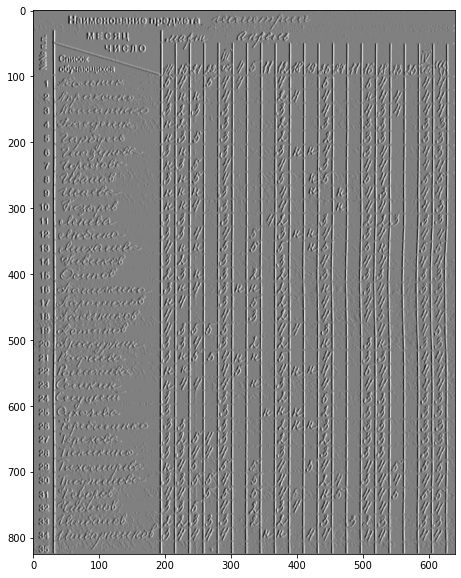

In [ ]:
plt.figure(figsize=(10, 10))
plt.imshow(edges2, cmap='gray')
plt.show()

<string>:6: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.


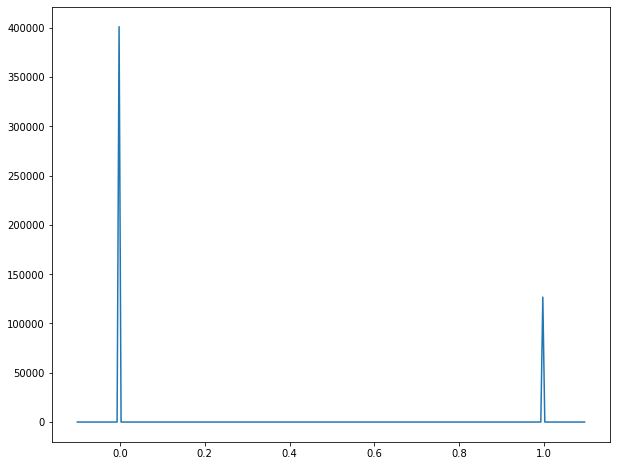

In [ ]:
histogram, bin_edges = np.histogram(edges1, bins=256, range=(-0.1, 1.1))
plt.figure(figsize=(10, 8))
plt.plot(bin_edges[0:-1], histogram) 

## Summ image as array

### axis 1

In [ ]:
image_gray_resized = cv2.resize(image_gray, (512, 512), interpolation = cv2.INTER_AREA)

In [ ]:
sum_array = np.sum(image_gray_resized, axis=1)
#print(sum_array)

In [ ]:
peaks, _ = find_peaks(-sum_array, height=-400, distance = 10)
print(peaks)

[  8  18  30  61  74  87 100 113 126 139 152 165 178 191 203 216 229 242
 255 268 281 294 306 319 332 345 358 371 384 396 409 422 435 448 461 474
 487 499]


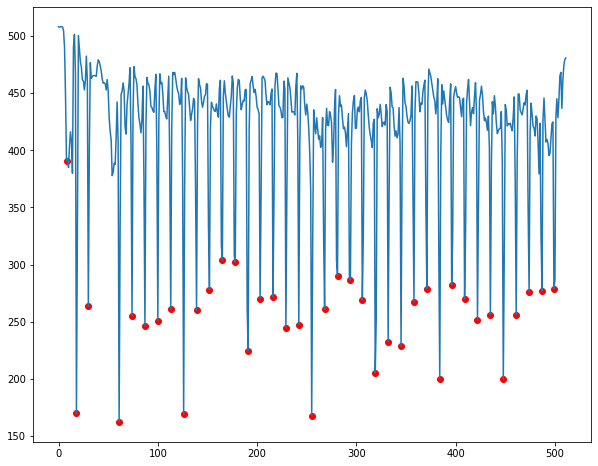

In [ ]:
plt.figure(figsize=(10, 8))
plt.scatter(peaks, [sum_array[peak] for peak in peaks], c = 'r')
plt.plot(sum_array)

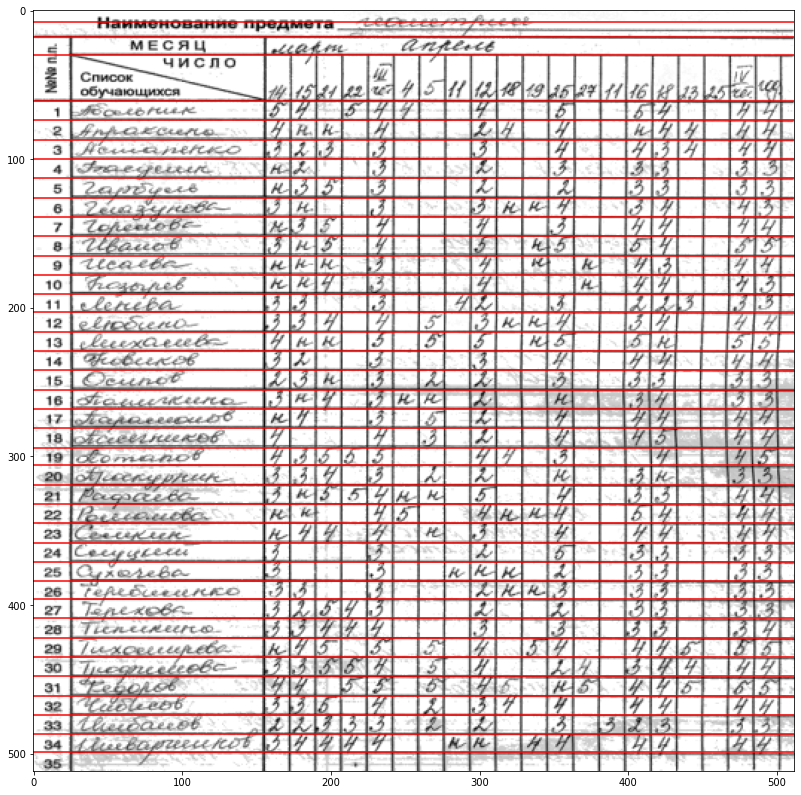

In [ ]:
plt.figure(figsize=(14, 14))
plt.imshow(image_gray_resized, cmap='gray')
for border in peaks:
  plt.axhline(y=border, color='r', linestyle='-')
plt.show()

### axis 0

In [ ]:
sum_array_vertical = np.sum(image_gray_resized, axis=0)

In [ ]:
peaks_vertical, _ = find_peaks(-sum_array_vertical, height=-300, distance = 10)
print(peaks_vertical)

[  8  18  30  61  74  87 100 113 126 139 152 165 178 191 203 216 229 242
 255 268 281 294 306 319 332 345 358 371 384 396 409 422 435 448 461 474
 487 499]


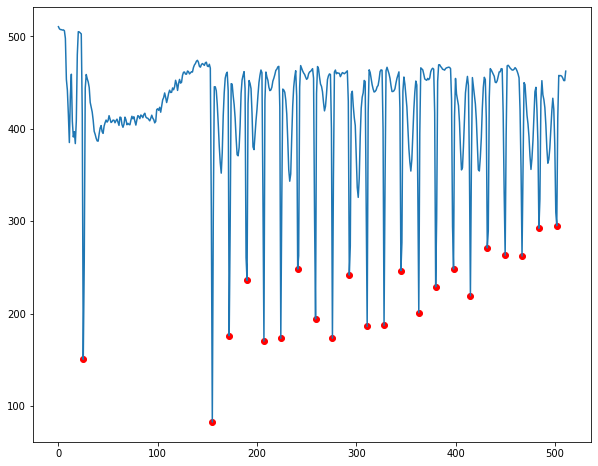

In [ ]:
plt.figure(figsize=(10, 8))
plt.scatter(peaks_vertical, [sum_array_vertical[peak] for peak in peaks_vertical], c = 'r')
plt.plot(sum_array_vertical)

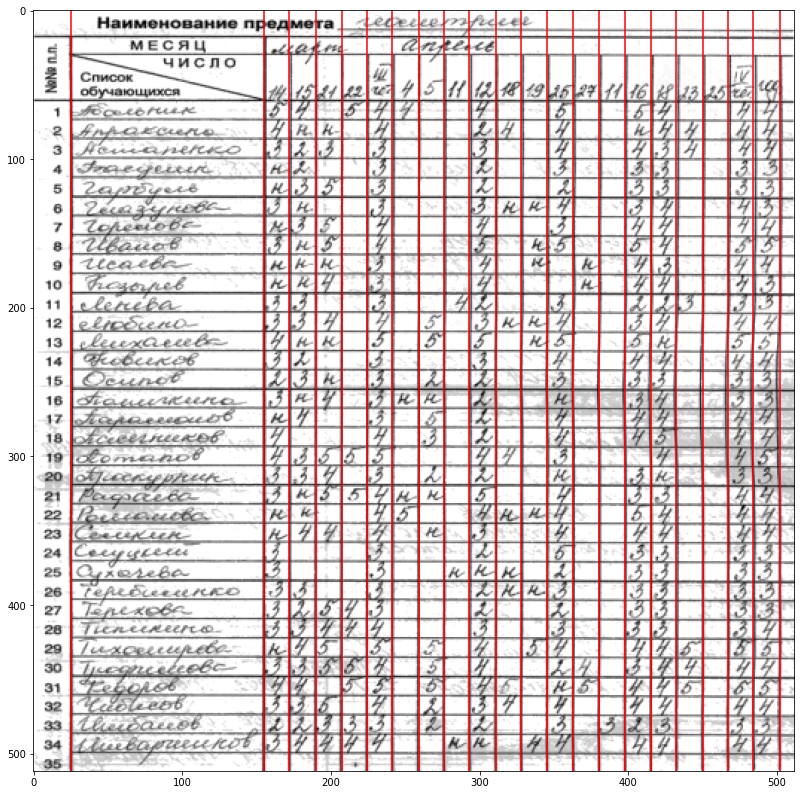

In [ ]:
plt.figure(figsize=(14, 14))
plt.imshow(image_gray_resized, cmap='gray')
for border in peaks_vertical:
  plt.axvline(x=border, color='r', linestyle='-')
plt.show()

In [ ]:
orig_img_resized = cv2.resize(test_image, (512, 512), interpolation = cv2.INTER_AREA)

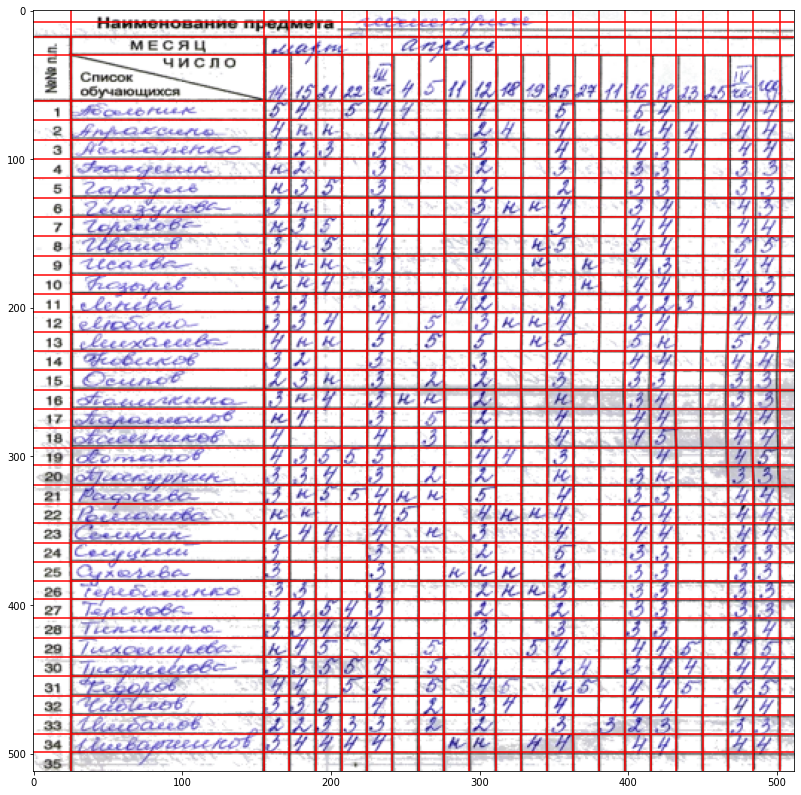

In [ ]:
plt.figure(figsize=(14, 14))
plt.imshow(orig_img_resized, cmap='gray')
for border in peaks_vertical:
  plt.axvline(x=border, color='r', linestyle='-')
for border in peaks:
  plt.axhline(y=border, color='r', linestyle='-')  
plt.show()

In [ ]:
for i in range(peaks.shape[0] - 1):
  for j in range(peaks_vertical.shape[0] - 1):
    cell = orig_img_resized[peaks[i]: peaks[i + 1],
               peaks_vertical[j]: peaks_vertical[j + 1]]
    cell = (cell * 255).astype(int)
    print(i, j)            
    plt.imshow(cell, cmap = 'gray')
    plt.show()

In [ ]:
j = 0
for i in range(peaks.shape[0] - 1):
    cell = orig_img_resized[peaks[i]: peaks[i + 1],
               peaks_vertical[j]: peaks_vertical[j + 1]]
    cell_adj_gamma = skimage.exposure.adjust_gamma(cell, 1) * 255              
    cell = cell_adj_gamma.astype(np.uint8)           
    print(i, j)            
    plt.imshow(cell, cmap = 'gray')
    plt.show()
    plt.imsave('test.png', cell) 

    text = pytesseract.image_to_string(Image.open('test.png'), lang="rus")
    print(text)

In [ ]:
orig_img_resized = cv2.resize(test_image, (512, 512), interpolation = cv2.INTER_AREA)

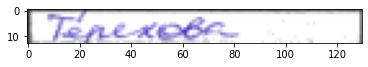

In [ ]:
test_cell_1 = orig_img_resized[peaks[29]: peaks[30],
               peaks_vertical[0]: peaks_vertical[1]] * 255
test_cell_1 = test_cell_1.astype(np.uint8)
plt.imshow(test_cell_1, cmap='gray')  
plt.imsave('terehova.png', test_cell_1)             

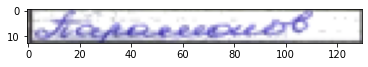

In [ ]:
test_cell_2 = orig_img_resized[peaks[19]: peaks[20],
               peaks_vertical[0]: peaks_vertical[1]] * 255
test_cell_2 = test_cell_2.astype(np.uint8)               
plt.imshow(test_cell_2, cmap='gray')  
plt.imsave('paramonov.png', test_cell_2)

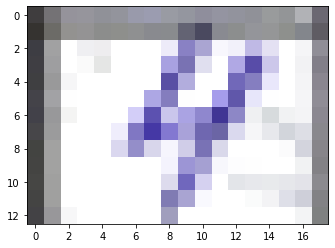

In [ ]:
test_cell_3 = orig_img_resized[peaks[32]: peaks[33],
               peaks_vertical[17]: peaks_vertical[18]] * 255
test_cell_3 = test_cell_3.astype(np.uint8)               
plt.imshow(test_cell_3, cmap='gray')  
plt.imsave('four.png', test_cell_3)

##Распознавание 

In [ ]:
text_1 = pytesseract.image_to_string(Image.open('terehova.png'), lang="rus")
print(text_1)

а ире жа.



In [ ]:
text_2 = pytesseract.image_to_string(Image.open('paramonov.png'), lang="rus")
print(text_2)

In [ ]:
text_1 = pytesseract.image_to_string(Image.open('four.png'), lang="rus")
print(text_2)

# Hough transform test

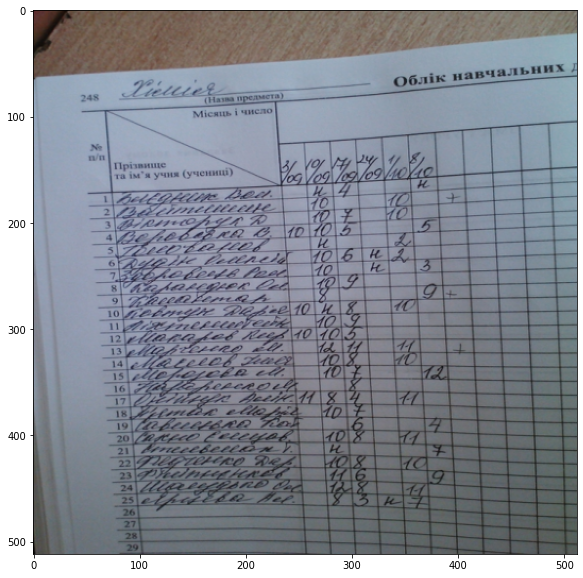

In [ ]:
test_img = plt.imread('/content/drive/MyDrive/journal_data/test8.png')
image_resized = cv2.resize(test_img, (512, 512), interpolation = cv2.INTER_AREA)
plt.figure(figsize = (10, 10))
plt.imshow(image_resized)

<class 'numpy.ndarray'> (512, 512)


<function matplotlib.pyplot.show>

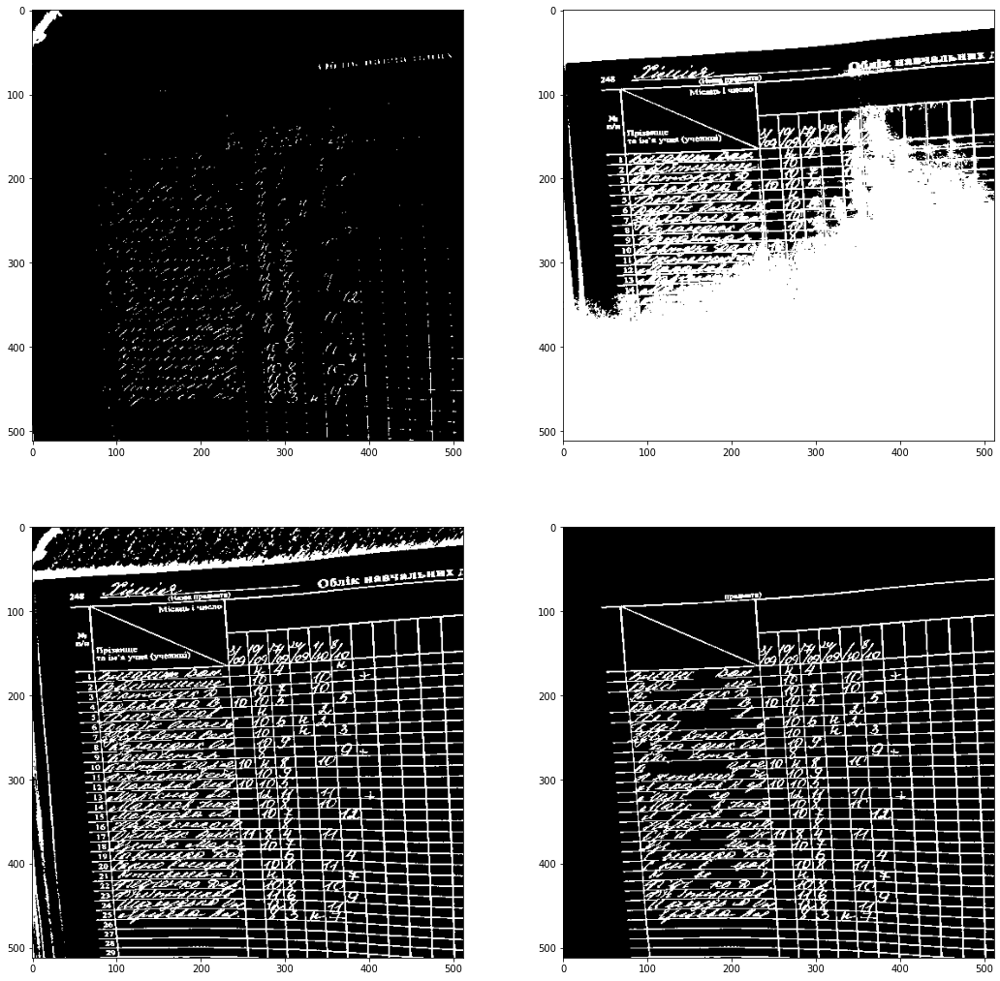

In [ ]:
# max_val_img = image_resized.max()
# converted_img = image_resized*-1 + image_resized.max()
# print(converted_img.min(), converted_img.max())

gray_img = skimage.color.rgb2gray(image_resized)
gray_img = gray_img < 0.2


adjusted = skimage.exposure.adjust_gamma(image_resized, gamma = 3)
gray_img_adj = skimage.color.rgb2gray(adjusted)
gray_img_adj = gray_img_adj < 0.2

gray_img_for_th = skimage.color.rgb2gray(adjusted)
th_value = skimage.filters.threshold_sauvola(gray_img_for_th, window_size=25)
print(type(th_value), th_value.shape)
thresholded_img = gray_img_for_th < th_value
thresholded_img_clean = skimage.morphology.remove_small_objects(thresholded_img, 10000)

fig, ax = plt.subplots(2,2, figsize = (18, 18))
ax[0,0].imshow(gray_img, cmap = 'gray')
ax[0,1].imshow(gray_img_adj, cmap = 'gray')
ax[1,0].imshow(thresholded_img, cmap = 'gray')
ax[1,1].imshow(thresholded_img_clean, cmap = 'gray')
plt.show

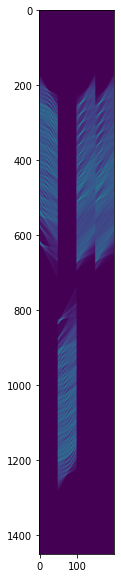

In [ ]:
#tested_angles = np.linspace(-np.pi/2, np.pi/2, 180)
eps = 0.1
bins = 50
tested_angles = np.concatenate((np.linspace(-np.pi/2 - eps, -np.pi/2 + eps, bins), 
                                np.linspace(np.pi/2 - eps, np.pi/2 + eps, bins),
                                np.linspace(-np.pi - eps, -np.pi + eps, bins),
                                np.linspace(np.pi - eps, np.pi + eps, bins)))
 
hspace, theta, dist = hough_line(thresholded_img_clean, tested_angles)

plt.figure(figsize = (10, 10))
plt.imshow(hspace)

In [ ]:
h, q, d = hough_line_peaks(hspace, theta, dist)

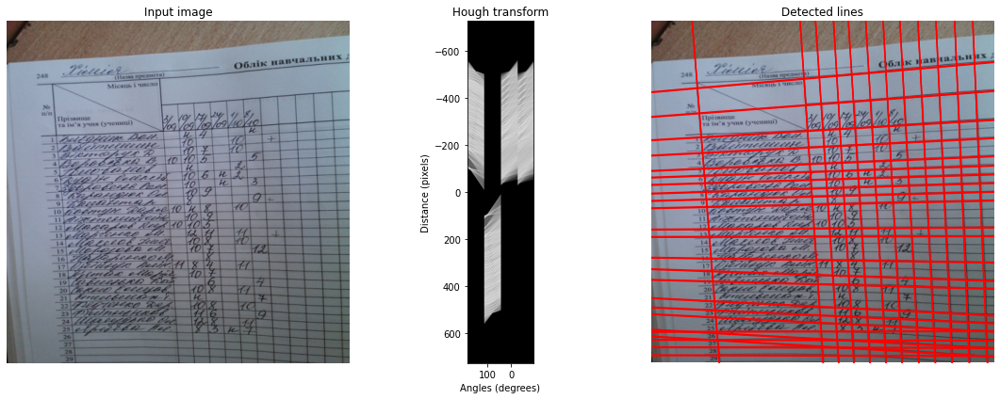

In [ ]:
angle_list = []

fig, axes = plt.subplots(1, 3, figsize = (15, 6))
ax = axes.ravel()

ax[0].imshow(image_resized, cmap='gray')
ax[0].set_title('Input image')
ax[0].set_axis_off()

ax[1].imshow(np.log(1 + hspace),
             extent=[np.rad2deg(theta[-1]), np.rad2deg(theta[0]), dist[-1], dist[0]],
             cmap='gray', aspect=1/1.5)
ax[1].set_title('Hough transform')
ax[1].set_xlabel('Angles (degrees)')
ax[1].set_ylabel('Distance (pixels)')
ax[1].axis('image')

ax[2].imshow(image_resized, cmap='gray')

origin = np.array((0, image_resized.shape[1]))

for _, angle, dist in zip(*hough_line_peaks(hspace, theta, dist)):
    angle_list.append(angle) #Not for plotting but later calculation of angles
    y0, y1 = (dist - origin * np.cos(angle)) / np.sin(angle)
    ax[2].plot(origin, (y0, y1), '-r')
ax[2].set_xlim(origin)
ax[2].set_ylim((image_resized.shape[0], 0))
ax[2].set_axis_off()
ax[2].set_title('Detected lines')

plt.tight_layout()
plt.show()


In [15]:
def hough_line_selection(image_path, eps = 0.1, bins = 50, gamma = 3, small_object_th = 10000, show_result = True):
  input_img = plt.imread(image_path)
  image_resized = cv2.resize(input_img, (512, 512), interpolation = cv2.INTER_AREA)

  adjusted = skimage.exposure.adjust_gamma(image_resized, gamma = gamma)
  gray_img_for_th = skimage.color.rgb2gray(adjusted)
  th_value = skimage.filters.threshold_sauvola(gray_img_for_th, window_size=25)
  thresholded_img = gray_img_for_th < th_value
  thresholded_img_clean = skimage.morphology.remove_small_objects(thresholded_img, small_object_th)
  
  tested_angles = np.concatenate((np.linspace(-np.pi/2 - eps, -np.pi/2 + eps, bins), 
                                  np.linspace(np.pi/2 - eps, np.pi/2 + eps, bins),
                                  np.linspace(-np.pi - eps, -np.pi + eps, bins),
                                  np.linspace(np.pi - eps, np.pi + eps, bins)))
  
  hspace, theta, dist = hough_line(thresholded_img_clean, tested_angles)

  if show_result:
    fig, ax = plt.subplots(1, 2, figsize = (15, 6))
    ax[0].imshow(thresholded_img_clean, cmap='gray')
    ax[1].imshow(image_resized)
    origin = np.array((0, image_resized.shape[1]))

    for _, angle, dist in zip(*hough_line_peaks(hspace, theta, dist)):
        y0, y1 = (dist - origin * np.cos(angle)) / np.sin(angle)
        if abs(angle) > 2: 
          y0 = max(y0, image_resized.shape[0]) if y0 < 0 else min(y0, image_resized.shape[0])
          y1 = max(y1, image_resized.shape[1]) if y1 < 0 else min(y1, image_resized.shape[1])


        #print(f"y0: {y0}, y1: {y1}, dist: {dist}, angle: {angle}")
        ax[1].plot(origin, (y0, y1), '-r')

    ax[1].set_xlim(origin)
    ax[1].set_ylim((image_resized.shape[0], 0))
    ax[1].set_title('Detected lines')

    plt.tight_layout()
    plt.show()

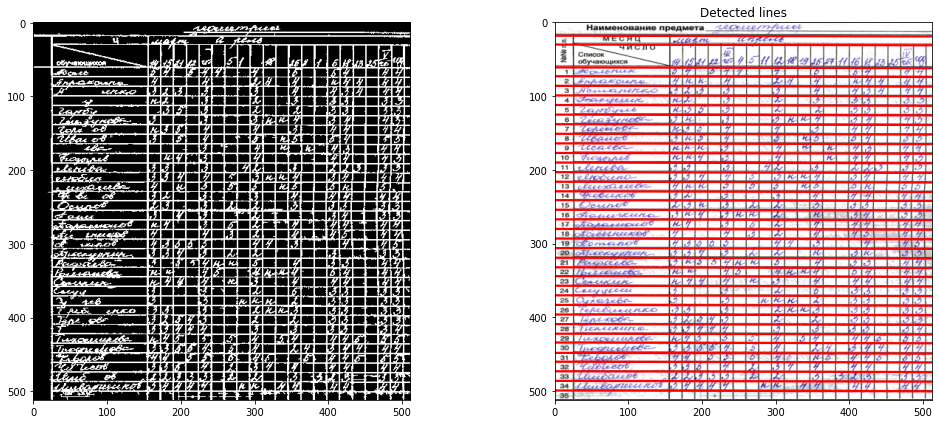

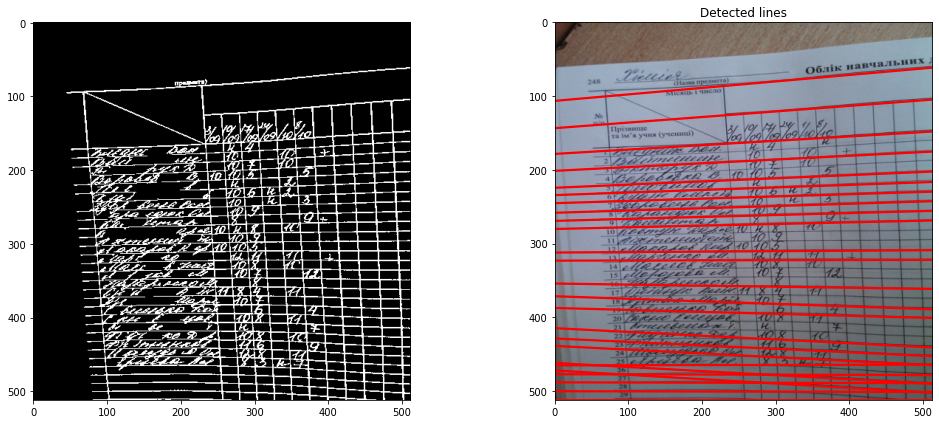

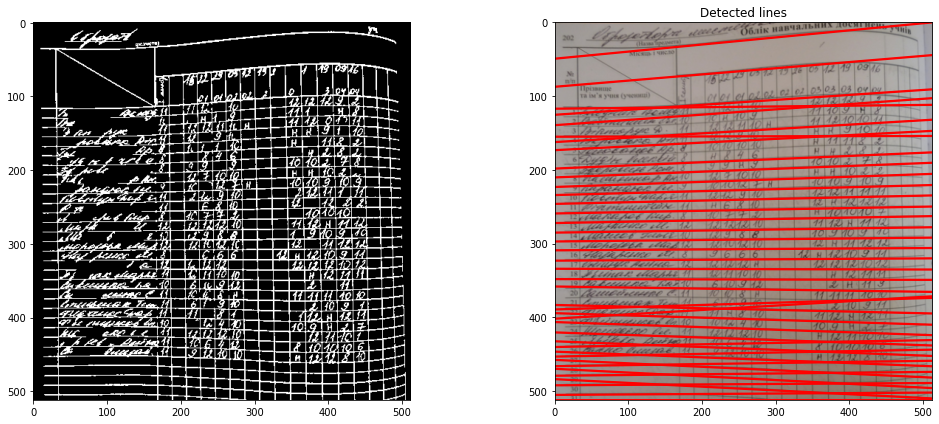

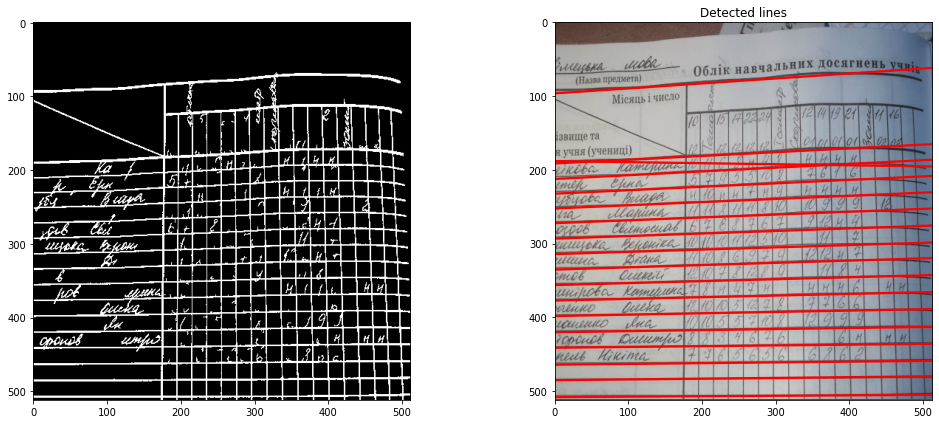

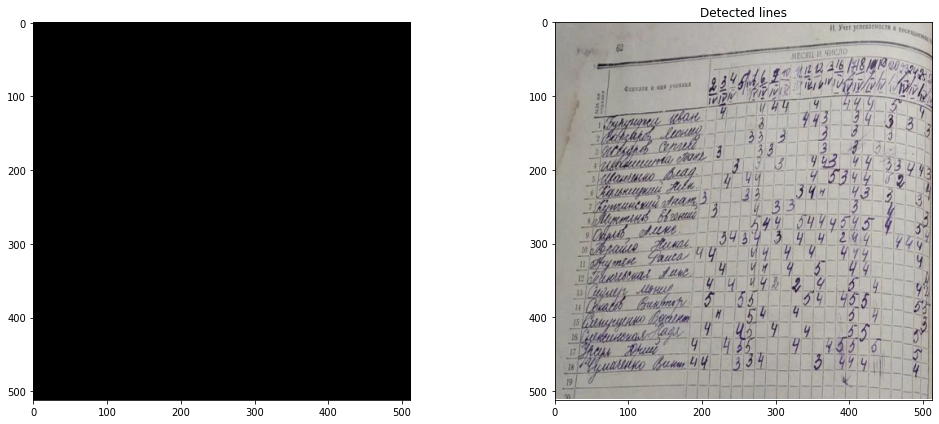

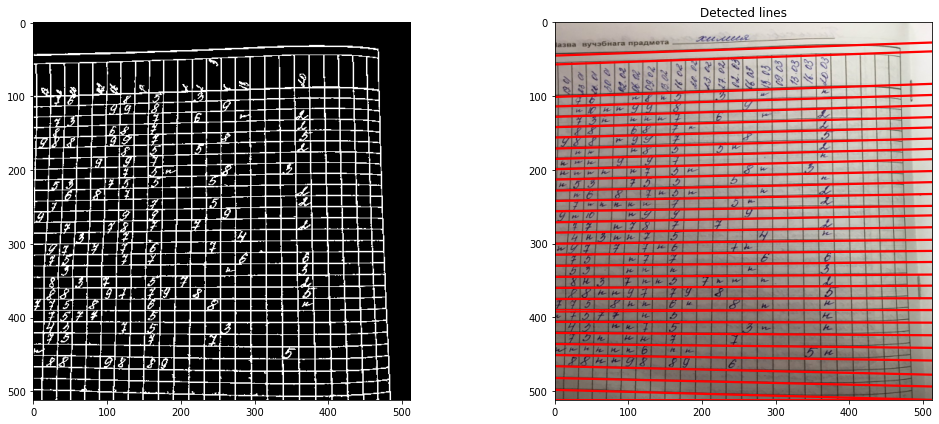

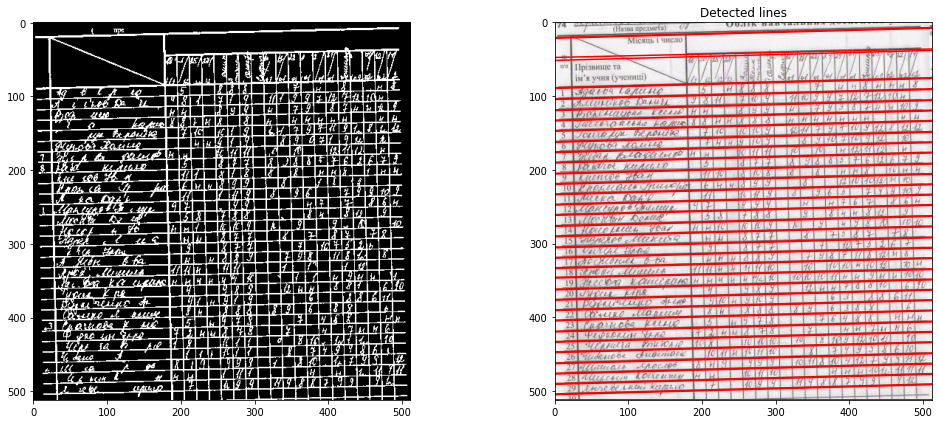

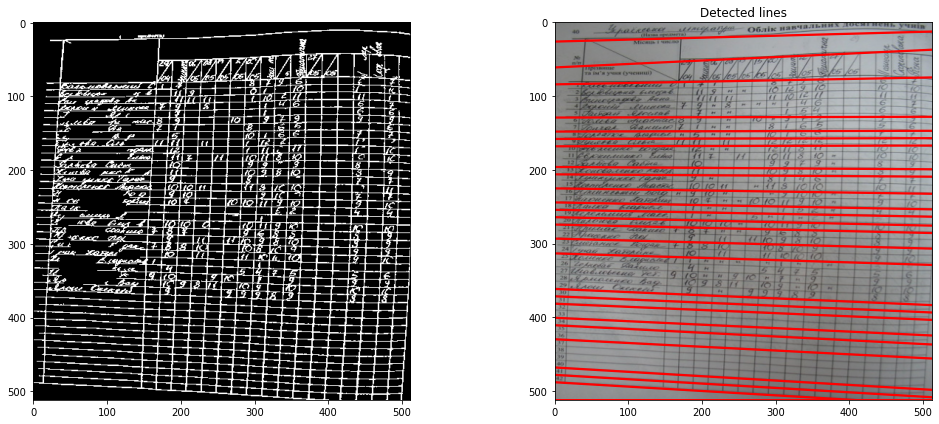

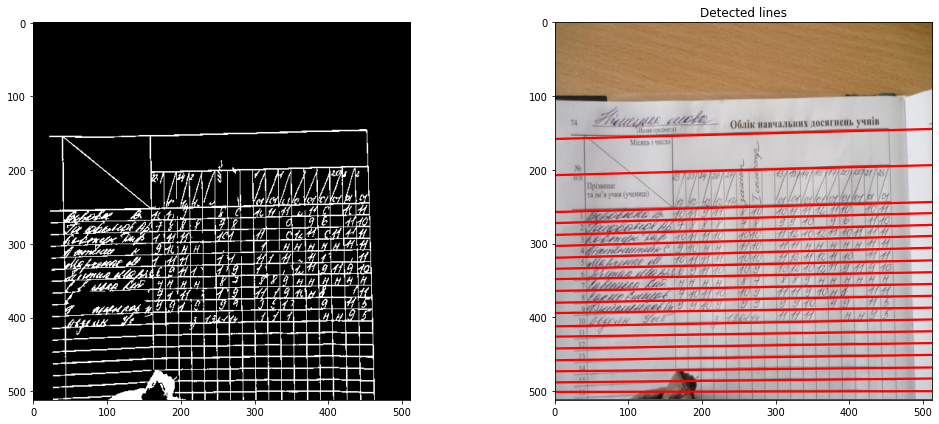

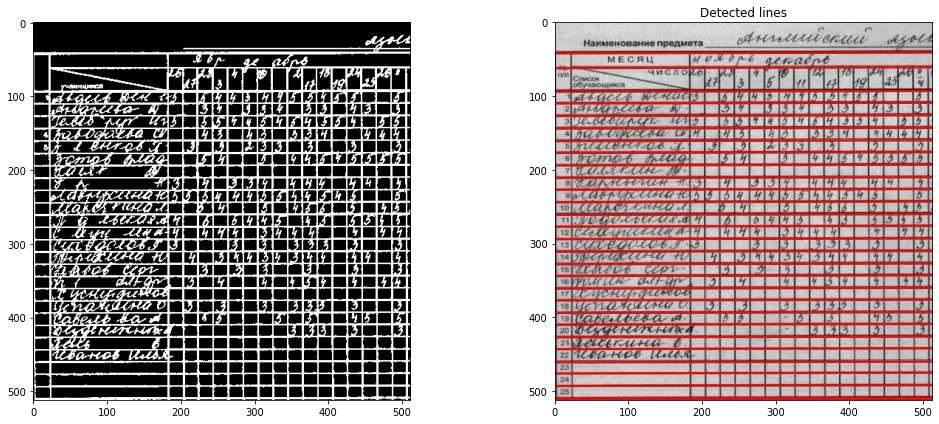

In [16]:
for img_path in glob('/content/drive/MyDrive/journal_data/test*'):
  hough_line_selection(img_path)